In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

# Specify the path to your CSV file
csv_file_path = "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/data/Feb_1_2024_MS_Train_Val_Datasets/MEDIQA-CORR-2024-MS-TrainingData.csv"
# csv_file_path = "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/data/Feb_1_2024_MS_Train_Val_Datasets/MS-train-augmented.csv"
# "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/outputs/2024-02-09/07-50-24/predictions_test.csv"
# "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/outputs/pythia_70m/2024-02-09/07-44-47/predictions_valid.csv"

# Load the CSV file into a pandas DataFrame
df = pd.read_csv(csv_file_path)

# i want to get differing part function to specify the part to be replace, replace Text with <BLANK>, and prompt 3.5. 
# i need new column that has replaced text "Masked Text"
# also the idea of back-translation... 
# the LM should be prompted with 

# file_path = '/mnt/data/my_dataframe.csv'  # Specify your file path here
# df.to_csv(file_path, index=False) 

display(df.head(5))

,Unnamed: 0,Text ID,Text,Sentences,Error Flag,Error Sentence ID,Error Sentence,Corrected Sentence,Corrected Text
0,0,ms-train-0,"A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae. An x-ray of the chest showed consolidation of the right upper lobe.","0 A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum.\n1 He works as a commercial fisherman on Lake Superior.\n2 Current medications include metoprolol and warfarin.\n3 His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm\n4 Hg.\n5 Examination shows increased fremitus and bronchial breath sounds over the right middle lung field.\n6 After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.\n7 An x-ray of the chest showed consolidation of the right upper lobe.",1,6,"After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.","After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae.","A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae. An x-ray of the chest showed consolidation of the right upper lobe."
1,1,ms-train-1,"A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. An x-ray of the chest shows consolidation of the right upper lobe. The causal pathogen is Streptococcus pneumoniae.","0 A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum.\n1 He works as a commercial fisherman on Lake Superior.\n2 Current medications include metoprolol and warfarin.\n3 His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm\n4 Hg.\n5 Examination shows increased fremitus and bronchial breath sounds over the right middle lung field.\n6 An x-ray of the chest shows consolidation of the right upper lobe.\n7 The causal pathogen is Streptococcus pneumoniae.",0,-1,NaN,NaN,NaN
2,2,ms-train-2,"A 9-year-old girl is brought to the pediatrician by her mother who reports that the girl has been complaining of genital itching over the past few days. She states she has noticed her daughter scratching her buttocks and anus for the past week; however, now she is scratching her groin quite profusely as well. The mother notices that symptoms seem to be worse at night. The girl is otherwise healthy, is up to date on her vaccinations, and feels well. She was recently treated with amoxicillin for a middle ear infection. The child also had a recent bought of diarrhea 

In [18]:
test_list = df["Correction"].tolist()
print(test_list[0][0])

Haemophilus influenzae.


In [2]:
print(df.shape)

df = df[~pd.isna(df['Corrected Sentence'])]
        
print(df.shape)

file_path = '/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/data/Feb_1_2024_MS_Train_Val_Datasets/MS-train-augmented.csv'  # Specify your file path here
df.to_csv(file_path, index=False) 

(2189, 9)
(1219, 9)


In [15]:
df['Correction'].dtype

dtype('O')

In [14]:
# i also didn't add blanked out column

df['Masked Text'] = None

# Iterate over the rows and perform the replacement
for index, row in df.iterrows():
    original_text = row['Text']
    replacement_tuple = row['Correction']
    if replacement_tuple:
        replacement_text = original_text.replace(replacement_tuple[0], "<BLANK>")
        df.at[index, 'Masked Text'] = replacement_text

display(df)



,Unnamed: 0,Text ID,Text,Sentences,Error Flag,Error Sentence ID,Error Sentence,Corrected Sentence,Corrected Text,Correction,Masked Text
0,0,ms-train-0,"A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae. An x-ray of the chest showed consolidation of the right upper lobe.","0 A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum.\n1 He works as a commercial fisherman on Lake Superior.\n2 Current medications include metoprolol and warfarin.\n3 His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm\n4 Hg.\n5 Examination shows increased fremitus and bronchial breath sounds over the right middle lung field.\n6 After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.\n7 An x-ray of the chest showed consolidation of the right upper lobe.",1,6,"After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.","After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae.","A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae. An x-ray of the chest showed consolidation of the right upper lobe.","(Haemophilus influenzae., Streptococcus pneumoniae.)","A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be <BLANK> An x-ray of the chest showed consolidation of the right upper lobe."
2,2,ms-train-2,"A 9-year-old girl is brought to the pediatrician by her mother who reports that the girl has been complaining of genital itching over the past few days. She states she has noticed her daughter scratching her buttocks and anus for the past week; however, now she is scratching her groin quite profusely as well. The mother notices that symptoms seem to be worse at night. The girl is otherwise healthy, is up to date on her vaccinations, and feels well. She was recently treated with amoxicillin for a middle ear infection. The child also had a recent bought of diarrhea that was profuse and watery that seems to be improving. Her temperature is 98.5 F (36.9 C), blood pressure is 111/70 mmHg, pulse is 83/min, respirations are 16/min, and oxygen saturation is 98% on room air. Physical exam is notable for excoriations over the girl's anus and near her vagina. Suspected of infection with Giardia lamblia.","0 A 9-year-old girl is brought to the pediatrician by her mother who reports that the girl has been complaining of genital itching over the past few days.\n1 She states she has noticed her da

In [2]:
csv_file_path_UW = "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/data/Feb_5_2024_UW_Validation_Set_Updated/MEDIQA-CORR-2024-UW-ValidationSet-1-Full_Feb.csv"
# "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/outputs/2024-02-09/07-50-24/predictions_test.csv"
# "/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/outputs/pythia_70m/2024-02-09/07-44-47/predictions_valid.csv"

# Load the CSV file into a pandas DataFrame
df_uw = pd.read_csv(csv_file_path_UW)
display(df_uw)

,Unnamed: 0,Text ID,Text,Sentences,Error Flag,Error Sentence ID,Error Sentence,Corrected Sentence,Corrected Text
0,0,uw-val-0,"Ms. <NAME/> is a <AGE/> yo F admitted from <NAME/> for evaluation and treatment of bilateral pelvic masses concerning for ovarian ca and partial small bowel obstruction. On admission nursing evaluated pts skin and notes a stg I pressure ulcer, open to air (see wound care flowsheet). Ms. <NAME/> is being managed for a stg I pressure ulcer, present on admission.","0 Ms. <NAME/> is a <AGE/> yo F admitted from <NAME/> for evaluation and treatment of bilateral pelvic masses concerning for ovarian ca and partial small bowel obstruction.\n1 On admission nursing evaluated pts skin and notes a stg I pressure ulcer, open to air (see wound care flowsheet).\n2 Ms. <NAME/> is being managed for a stg I pressure ulcer, present on admission.",0,-1,NaN,NaN,NaN
1,1,uw-val-1,Hypokalemia - based on laboratory findings patient has hypervalinemia. This may also contribute to cardiac arrythmia. Replacement ordered.,0 Hypokalemia - based on laboratory findings patient has hypervalinemia.\n1 This may also contribute to cardiac arrythmia.\n2 Replacement ordered.,1,0,Hypokalemia - based on laboratory findings patient has hypervalinemia.,Hypokalemia - based on laboratory findings patient has hypokalemia.,Hypokalemia - based on laboratory findings patient has hypokalemia. This may also contribute to cardiac arrythmia. Replacement ordered.
2,2,uw-val-2,This patient was admitted with a concomitant diagnosis of pseudohyponatremia. Ms. <NAME/> presented with intractable nausea and vomiting of unclear etiology. Her Na was 134 and management has included 3 L NS and monitoring of her BMP.,0 This patient was admitted with a concomitant diagnosis of pseudohyponatremia.\n1 Ms. <NAME/> presented with intractable nausea and vomiting of unclear etiology.\n2 Her Na was 134 and management has included 3 L NS and monitoring of her BMP.,1,0,This patient was admitted with a concomitant diagnosis of pseudohyponatremia.,This patient was admitted with a concomitant diagnosis of hyponatremia.,This patient was admitted with a concomitant diagnosis of hyponatremia. Ms. <NAME/> presented with intractable nausea and vomiting of unclear etiology. Her Na was 134 and management has included 3 L NS and monitoring of her BMP.
3,3,uw-val-3,"Ms. <NAME/> is being treated for continuous opioid and alcohol dependence with withdrawal. Pt is a <AGE/> yo F admitted with likely cellulitis. Pt is actively using heroin and etoh and has h/o multiple abscesses 2/2 IVDU. Pt is noted to have CIWA scores <DATE/> ranging 11-16 with nursing noting pt being very irritable/agitated, with moderate tremors, is moderately anxious and with paroxysmal sweats. Pt also c/o pain (difficult to control and chronic) with nausea and is treated with morphine, oxycodone, IV lorazepam and CIWA protocol scoring.","0 Ms. <NAME/> is being treated for continuous opioid and alcohol dependence with withdrawal.\n1 Pt is a <AGE/> yo F admitted with likely cellulitis.\n2 Pt is actively using heroin and etoh and has h/o multiple abscesses 2/2 IVDU.\n3 Pt is noted to have CIWA scores <DATE/> ranging 11-16 with nursing noting pt being very irritable/agitated, with moderate tremors, is moderately anxious and with paroxysmal sweats.\n4 Pt also c/o pain (difficult to control and chronic) with nausea and is treated with morphine, oxycodone, IV lorazepam and CIWA protocol scoring.",0,-1,NaN,NaN,NaN
4,4,uw-val-4,"Mr. <NAME/> is a <AGE/> YO M presented to ED <DATE/> following a ground level fall with complaints of weakness with cognitive and physical decline. Pt presented to ED with SBP 126 which slowly declines until <DATE/> when STAT RN notes Pt. was hypotensive with SBP 77-80s (baseline SBP 130-140s per chart). First blood cultures are drawn on this date (<DATE/>) which were positive for Group B Streptococcus; likely source discovered to be LUE abscess. Infectious workup was begun on admit with CXR and UA, but 

In [3]:
display(df)

,Unnamed: 0,Text ID,Text,Sentences,Error Flag,Error Sentence ID,Error Sentence,Corrected Sentence,Corrected Text
0,0,ms-train-0,"A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae. An x-ray of the chest showed consolidation of the right upper lobe.","0 A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum.\n1 He works as a commercial fisherman on Lake Superior.\n2 Current medications include metoprolol and warfarin.\n3 His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm\n4 Hg.\n5 Examination shows increased fremitus and bronchial breath sounds over the right middle lung field.\n6 After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.\n7 An x-ray of the chest showed consolidation of the right upper lobe.",1,6,"After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.","After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae.","A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae. An x-ray of the chest showed consolidation of the right upper lobe."
1,1,ms-train-1,"A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum. He works as a commercial fisherman on Lake Superior. Current medications include metoprolol and warfarin. His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm Hg. Examination shows increased fremitus and bronchial breath sounds over the right middle lung field. An x-ray of the chest shows consolidation of the right upper lobe. The causal pathogen is Streptococcus pneumoniae.","0 A 53-year-old man comes to the physician because of a 1-day history of fever and chills, severe malaise, and cough with yellow-green sputum.\n1 He works as a commercial fisherman on Lake Superior.\n2 Current medications include metoprolol and warfarin.\n3 His temperature is 38.5 C (101.3 F), pulse is 96/min, respirations are 26/min, and blood pressure is 98/62 mm\n4 Hg.\n5 Examination shows increased fremitus and bronchial breath sounds over the right middle lung field.\n6 An x-ray of the chest shows consolidation of the right upper lobe.\n7 The causal pathogen is Streptococcus pneumoniae.",0,-1,NaN,NaN,NaN
2,2,ms-train-2,"A 9-year-old girl is brought to the pediatrician by her mother who reports that the girl has been complaining of genital itching over the past few days. She states she has noticed her daughter scratching her buttocks and anus for the past week; however, now she is scratching her groin quite profusely as well. The mother notices that symptoms seem to be worse at night. The girl is otherwise healthy, is up to date on her vaccinations, and feels well. She was recently treated with amoxicillin for a middle ear infection. The child also had a recent bought of diarrhea 

In [4]:
df[df["Error Sentence ID"]==2]

,Unnamed: 0,Text ID,Text,Sentences,Error Flag,Error Sentence ID,Error Sentence,Corrected Sentence,Corrected Text
41,41,ms-train-41,"A 45-year-old woman comes to the emergency department because of abdominal cramping, vomiting, and watery diarrhea for the past 4 hours. One day ago, she went to a seafood restaurant with her family to celebrate her birthday. Cultures grew salmonella enterica. Three of the attendees have developed similar symptoms. The patient appears lethargic. Her temperature is 38.8 C (101.8 F).","0 A 45-year-old woman comes to the emergency department because of abdominal cramping, vomiting, and watery diarrhea for the past 4 hours.\n1 One day ago, she went to a seafood restaurant with her family to celebrate her birthday.\n2 Cultures grew salmonella enterica.\n3 Three of the attendees have developed similar symptoms.\n4 The patient appears lethargic.\n5 Her temperature is 38.8 C (101.8 F).",1,2,Cultures grew salmonella enterica.,Cultures grew Vibrio parahaemolyticus.,"A 45-year-old woman comes to the emergency department because of abdominal cramping, vomiting, and watery diarrhea for the past 4 hours. One day ago, she went to a seafood restaurant with her family to celebrate her birthday. Cultures grew Vibrio parahaemolyticus. Three of the attendees have developed similar symptoms. The patient appears lethargic. Her temperature is 38.8 C (101.8 F)."
114,114,ms-train-114,A 3-month old male infant with HIV infection is brought to the physician for evaluation. The physician recommends monthly intramuscular injections of a monoclonal antibody to protect against a particular infection. The causal pathogen for this infection is transmitted by blood transfusion.,0 A 3-month old male infant with HIV infection is brought to the physician for evaluation.\n1 The physician recommends monthly intramuscular injections of a monoclonal antibody to protect against a particular infection.\n2 The causal pathogen for this infection is transmitted by blood transfusion.,1,2,The causal pathogen for this infection is transmitted by blood transfusion.,The causal pathogen for this infection is transmitted by aerosol inhalation.,A 3-month old male infant with HIV infection is brought to the physician for evaluation. The physician recommends monthly intramuscular injections of a monoclonal antibody to protect against a particular infection. The causal pathogen for this infection is transmitted by aerosol inhalation.
115,115,ms-train-115,"A 34-year-old man with AIDS comes to the physician because of a 2-day history of decreasing vision and seeing black spots in his right eye. He has no pain and the left eye is asymptomatic. HIV retinopathy suspected. He was treated for fungal esophagitis 6 months ago with fluconazole. He was diagnosed with Kaposi's sarcoma 2 years ago. Current medications include efavirenz, tenofovir, emtricitabine, azithromycin, trimethoprim-sulfamethoxazole, multivitamins, and a nutritional supplement. He is 170 cm (5 ft 7 in) tall and weighs 45 kg (99 lbs);BMI is 15.6 kg/m2. His temperature is 37 C (98.6 F), pulse is 89/min, and blood pressure is 110/70 mm Hg. Examination shows cervical lymphadenopathy. There are multiple violaceous plaques seen over his trunk and extremities. Fundoscopic examination shows granular yellow-white opacities around the retinal vessels and multiple areas of dot-blot hemorrhages. His CD4+ T-lymphocyte count is 36/mm3.","0 A 34-year-old man with AIDS comes to the physician because of a 2-day history of decreasing vision and seeing black spots in his right eye.\n1 He has no pain and the left eye is asymptomatic.\n2 HIV retinopathy suspected.\n3 He was treated for fungal esophagitis 6 months ago with fluconazole.\n4 He was diagnosed with Kaposi's sarcoma 2 years ago.\n5 Current medications include efavirenz, tenofovir, emtricitabine, azithromycin, trimethoprim-sulfamethoxazole, multivitamins, and a nutritional supplement.\n6 He is 170 cm (5 ft 7 in) tall and weighs 45 kg (99 lbs);BMI is 15.6 

In [5]:
i=0
for error_sent, corr_sent in zip(df["Error Sentence"], df["Corrected Sentence"]):
    print(error_sent)
    # print()
    print(corr_sent)
    print()
    i+=1
    if i>15:
        break



After reviewing imaging, the causal pathogen was determined to be Haemophilus influenzae.
After reviewing imaging, the causal pathogen was determined to be Streptococcus pneumoniae.

nan
nan

Suspected of infection with Giardia lamblia.
Suspected of infection with Enterobius vermicularis.

nan
nan

Causal organism is Staphylococcus epidermidis.
Causal organism is Staphylococcus aureus.

nan
nan

Patient is diagnosed with an EBV infection.
Patient is diagnosed with an HSV-1 infection.

nan
nan

Bartonella henselae was determined as the causal organism.
Sporothrix schenckii was determined as the causal organism.

Culture confirms Nocardia asteroides.
Culture confirms Actinomyces israelii.

Culture reports indicate the presence of streptococcus gallolyticus.
Culture reports indicate the presence of Streptococcus sanguinis.

nan
nan

Patient has a Rhizopus oryzae infection.
Patient has a Clostridium perfringens infection.

Further evaluation reveals Neisseria gonorrhoeae as the causal path

In [4]:
def find_error_span(sentence1, sentence2):
    differing_parts_sentence1 = []
    differing_parts_sentence2 = []

    if pd.isnull(sentence1):
        sentence1_words = []
    else:
        sentence1_words = sentence1.split()

    if pd.isnull(sentence2):
        sentence2_words = []
    else:
        sentence2_words = sentence2.split()

    for word in sentence1_words:
        if word not in sentence2_words:
            differing_parts_sentence1.append(word)

    for word in sentence2_words:
        if word not in sentence1_words:
            differing_parts_sentence2.append(word)

    return (" ".join(differing_parts_sentence1), " ".join(differing_parts_sentence2))

# Example usage:
sentence1 = "Patient is diagnosed with an EBV infection."
sentence2 = "Patient is diagnosed with an HSV-1 infection."

error_span = find_error_span(sentence1, sentence2)
print(type(error_span))


<class 'tuple'>


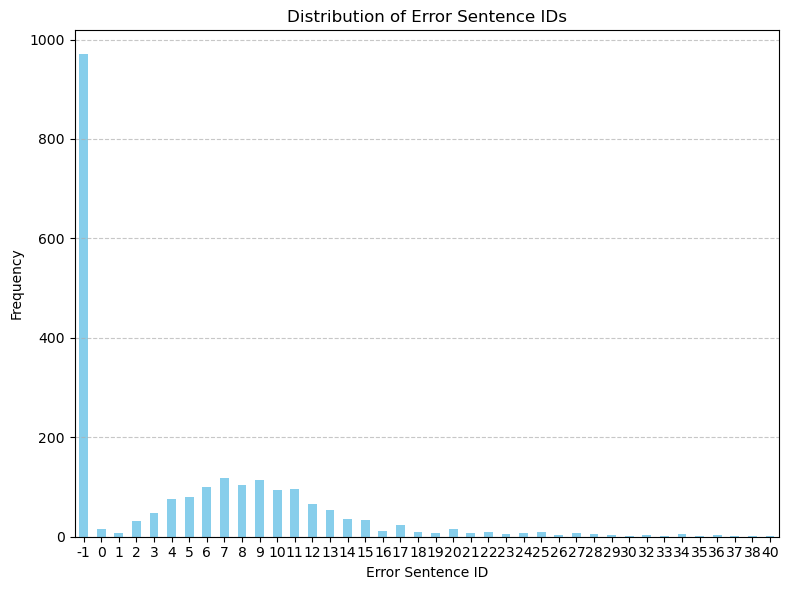

In [9]:

value_counts = df["Error Sentence ID"].value_counts()

# Sort the values
value_counts_sorted = value_counts.sort_index()

# Plotting
plt.figure(figsize=(8, 6))
value_counts_sorted.plot(kind='bar', color='skyblue')
plt.title('Distribution of Error Sentence IDs')
plt.xlabel('Error Sentence ID')
plt.ylabel('Frequency')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [10]:
df.shape # (2189, 9)
df.columns # ['Unnamed: 0', 'Text ID', 'Text', 'Sentences', 'Error Flag', 'Error Sentence ID', 'Error Sentence', 'Corrected Sentence', 'Corrected Text']

Index(['Unnamed: 0', 'Text ID', 'Text', 'Sentences', 'Error Flag',
       'Error Sentence ID', 'Error Sentence', 'Corrected Sentence',
       'Corrected Text'],
      dtype='object')

In [10]:
df['Error Span'], df['Corrected Span'] = None, None

# df.loc[df['Corrected Sentence'].isna(), 'Correction'] = "NA"

df['Error Span'], df['Corrected Span'] = df.apply(lambda row: find_error_span(row['Error Sentence'], row['Corrected Sentence']), axis=1)
# df['Correction'] = df.apply(lambda row: find_error_span(row['Error Sentence'], row['Corrected Sentence']) if pd.notnull(row['Corrected Sentence']) else None, axis=1)


In [11]:
# display(df.head(5))
df['Correction'][0][0]

'Haemophilus influenzae.'

In [12]:
df['Correction'].isna().sum()

0

In [13]:
df['Correction'].dtype

dtype('O')

In [15]:

# df = df[df['Correction']!=None]

print(df.shape)

file_path = '/Users/chaeeunlee/Documents/VSC_workspaces/mediqa/data/Feb_1_2024_MS_Train_Val_Datasets/MS-train-augmented.csv'  # Specify your file path here
df.to_csv(file_path, index=False) 

(1219, 11)


In [5]:
i=0
for diff_parts in df['Correction']:
    incorrect = diff_parts
    if incorrect[0]!='':
        print(incorrect)
    # print()
    # print(corr_sent)
    print()
    i+=1
    # if i>15:
    #     break



('Haemophilus influenzae.', 'Streptococcus pneumoniae.')


('Giardia lamblia.', 'Enterobius vermicularis.')


('epidermidis.', 'aureus.')


('EBV', 'HSV-1')


('Bartonella henselae', 'Sporothrix schenckii')

('Nocardia asteroides.', 'Actinomyces israelii.')

('streptococcus gallolyticus.', 'Streptococcus sanguinis.')


('Rhizopus oryzae', 'Clostridium perfringens')

('Neisseria gonorrhoeae', 'chlamydia trachomatis')

('Coxiella burneti', 'Chlamydophila psittaci')


('Neisseria meningitidis.', 'herpes simplex virus.')


('black widow', 'brown recluse')


('Neisseria gonorrhoeae.', 'chlamydia trachomatis.')


('Histoplasma capsulatum', 'Aspergillus fumigatus')


('an aerobic, chains.', 'a facultative anaerobic, clusters.')

('Pneumocystis', 'Neisseria')


('human herpes virus 4.', 'adenovirus.')


('paramyxovirus', 'togavirus')


('herpes simplex virus.', 'Streptococcus agalactiae.')


('streptococcus gallolyticus', 'Viridans streptococci')


('Ascaris lumbricoides.', 'Echinococcus granu

word_freq = {'After': 39, 'reviewing': 12, 'imaging,': 6, 'the': 405, 'causal': 15, 'pathogen': 3, 'was': 479, 'determined': 4, 'to': 262, 'be': 25, 'Haemophilus': 2, 'influenzae.': 2, 'Suspected': 65, 'of': 253, 'infection': 23, 'with': 301, 'Giardia': 2, 'lamblia.': 1, 'Causal': 1, 'organism': 7, 'is': 549, 'Staphylococcus': 4, 'epidermidis.': 1, 'Patient': 260, 'diagnosed': 180, 'an': 54, 'EBV': 1, 'infection.': 13, 'Bartonella': 1, 'henselae': 1, 'as': 20, 'organism.': 5, 'Culture': 3, 'confirms': 5, 'Nocardia': 1, 'asteroides.': 1, 'reports': 7, 'indicate': 4, 'presence': 3, 'streptococcus': 3, 'gallolyticus.': 1, 'has': 9, 'a': 156, 'Rhizopus': 1, 'oryzae': 1, 'Further': 7, 'evaluation': 8, 'reveals': 13, 'Neisseria': 6, 'gonorrhoeae': 1, 'pathogen.': 3, 'Coxiella': 1, 'burneti': 1, 'confirmed': 9, 'after': 96, 'x-ray': 9, 'chest': 16, 'shows': 36, 'diffuse': 4, 'patchy': 1, 'infiltrates': 1, 'that': 24, 'are': 37, 'most': 5, 'prominent': 2, 'in': 68, 'lower': 3, 'lobes.': 1, 'Th

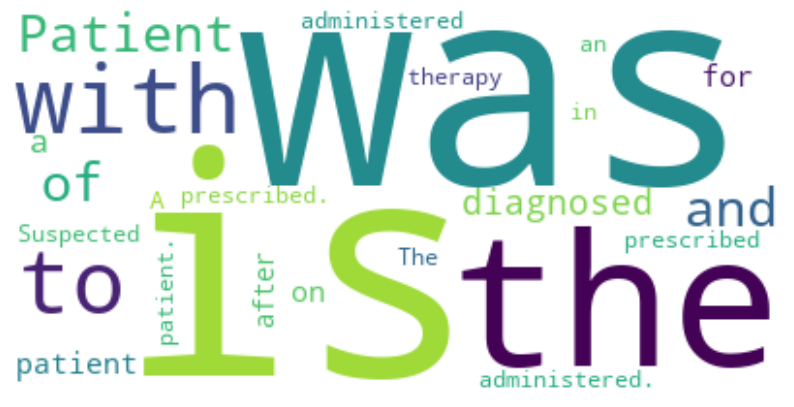

In [25]:


def generate_word_bubble(dataframe, column_name):
    dataframe[column_name] = dataframe[column_name].fillna('')
    # Concatenate all sentences into a single string
    all_text = ' '.join(dataframe[column_name].values.tolist())
    
    # Split the text into words
    words = all_text.split()
    
    # Create a frequency dictionary for words
    word_freq = {}
    for word in words:
        word_freq[word] = word_freq.get(word, 0) + 1

    print(f"word_freq = {word_freq}")
    
    # Filter words appearing more than 50 times
    frequent_words = {word: freq for word, freq in word_freq.items() if (freq > 50)} # & freq < 100)}
    
    # Generate word cloud
    wordcloud = WordCloud(background_color='white').generate_from_frequencies(frequent_words)
    
    # Display the word cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

    return word_freq

# Example usage:
# Suppose you have a DataFrame named df with a column 'sentences' containing the sentences
# You can call the function like this:
word_freq_dict = generate_word_bubble(df, 'Error Sentence')


In [26]:
from collections import OrderedDict

# Original dictionary
# original_dict = {'A': 2624, '53-year-old': 22, 'man': 747, 'comes': 500}

# Sort the dictionary by values in descending order
sorted_dict = OrderedDict(sorted(word_freq_dict.items(), key=lambda x: x[1], reverse=True))

print(sorted_dict)

OrderedDict([('is', 549), ('was', 479), ('the', 405), ('with', 301), ('to', 262), ('Patient', 260), ('of', 253), ('and', 245), ('diagnosed', 180), ('a', 156), ('patient', 113), ('on', 111), ('for', 106), ('after', 96), ('A', 77), ('in', 68), ('administered.', 66), ('prescribed', 66), ('Suspected', 65), ('patient.', 64), ('therapy', 62), ('The', 60), ('prescribed.', 55), ('an', 54), ('administered', 53), ('were', 50), ('recommended.', 48), ('following', 47), ('Based', 45), ('ordered.', 43), ('required.', 42), ('further', 40), ('recommended', 40), ('After', 39), ('are', 37), ('Diagnosis', 37), ('performed.', 37), ('shows', 36), ('CT', 36), ('disorder.', 31), ('given', 31), ('scheduled', 31), ('scan', 30), ('based', 28), ('evaluate.', 27), ('examining', 26), ('ordered', 26), ('be', 25), ('started', 25), ('his', 25), ('that', 24), ('her', 24), ('addition', 24), ('infection', 23), ('exam', 23), ('findings.', 23), ('oral', 23), ('treated', 23), ('biopsy', 22), ("patient's", 21), ('patient,',

In [27]:
len(sorted_dict)

2971

In [14]:
# which prediction does the accuracy look at? -> either flags or idx. they can be merged into one. 

df[df['Error Flag']==0]['Corrected Sentence'] # NaN

1       NaN
3       NaN
5       NaN
7       NaN
11      NaN
15      NaN
17      NaN
19      NaN
21      NaN
23      NaN
26      NaN
28      NaN
30      NaN
32      NaN
34      NaN
36      NaN
38      NaN
40      NaN
42      NaN
44      NaN
46      NaN
48      NaN
50      NaN
52      NaN
54      NaN
56      NaN
58      NaN
60      NaN
62      NaN
65      NaN
67      NaN
69      NaN
71      NaN
73      NaN
75      NaN
79      NaN
81      NaN
83      NaN
85      NaN
87      NaN
89      NaN
91      NaN
94      NaN
96      NaN
98      NaN
100     NaN
102     NaN
104     NaN
106     NaN
108     NaN
111     NaN
113     NaN
116     NaN
118     NaN
120     NaN
122     NaN
124     NaN
126     NaN
128     NaN
130     NaN
133     NaN
135     NaN
137     NaN
140     NaN
142     NaN
144     NaN
146     NaN
149     NaN
151     NaN
153     NaN
155     NaN
157     NaN
159     NaN
161     NaN
163     NaN
165     NaN
167     NaN
170     NaN
172     NaN
174     NaN
176     NaN
178     NaN
180     NaN
183 

In [15]:
# what should the input be? -> i mean since this is a 'statistic', it would have to be ALL the instances. 
# what does a single label look like? -> the sentence idx (could -1) 


def accuracy(y_true, y_pred):
    """
    Calculate accuracy for a classification task with a varying number of classes per instance.

    Parameters:
    y_true (list of lists): True labels for each instance. Each element is a list containing true labels.
    y_pred (list of lists): Predicted labels for each instance. Each element is a list containing predicted labels.

    Returns:
    float: Accuracy score.
    """
    total_instances = len(y_true)
    correct_predictions = 0

    for true_labels, pred_labels in zip(y_true, y_pred):
        if set(true_labels) == set(pred_labels):
            correct_predictions += 1

    return correct_predictions / total_instances
